<a href="https://colab.research.google.com/github/levent77/244327008_Levent_OZBINGOLLU/blob/main/leventozbingollu.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import seaborn as sns
sns.set()

In [ ]:
!git clone https://github.com/hardik0/AI-for-Medicine-Specialization
%cd AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/

Cloning into 'AI-for-Medicine-Specialization'...
remote: Enumerating objects: 1601, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 1601 (delta 9), reused 2 (delta 0), pack-reused 1573 (from 1)
Receiving objects: 100% (1601/1601), 720.36 MiB | 39.50 MiB/s, done.
Resolving deltas: 100% (30/30), done.
Updating files: 100% (1497/1497), done.
/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis


Dataset yükleme.

In [ ]:
%ls nih/

densenet.hdf5  images_small/  pretrained_model.h5  test.csv  train-small.csv  valid-small.csv


In [ ]:
train_df = pd.read_csv("nih/train-small.csv")
print(f'There are {train_df.shape[0]} rows and {train_df.shape[1]} columns in this data frame')
train_df.head()

There are 1000 rows and 16 columns in this data frame


,Image,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,PatientId,Pleural_Thickening,Pneumonia,Pneumothorax
0,00008270_015.png,0,0,0,0,0,0,0,0,0,0,0,8270,0,0,0
1,00029855_001.png,1,0,0,0,1,0,0,0,1,0,0,29855,0,0,0
2,00001297_000.png,0,0,0,0,0,0,0,0,0,0,0,1297,1,0,0
3,00012359_002.png,0,0,0,0,0,0,0,0,0,0,0,12359,0,0,0
4,00017951_001.png,0,0,0,0,0,0,0,0,1,0,0,17951,0,0,0


In [ ]:
print(train_df.info())
unique_patients = train_df['PatientId'].nunique()
print(f"Benzersiz hasta sayısı: {unique_patients}")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Image               1000 non-null   object
 1   Atelectasis         1000 non-null   int64 
 2   Cardiomegaly        1000 non-null   int64 
 3   Consolidation       1000 non-null   int64 
 4   Edema               1000 non-null   int64 
 5   Effusion            1000 non-null   int64 
 6   Emphysema           1000 non-null   int64 
 7   Fibrosis            1000 non-null   int64 
 8   Hernia              1000 non-null   int64 
 9   Infiltration        1000 non-null   int64 
 10  Mass                1000 non-null   int64 
 11  Nodule              1000 non-null   int64 
 12  PatientId           1000 non-null   int64 
 13  Pleural_Thickening  1000 non-null   int64 
 14  Pneumonia           1000 non-null   int64 
 15  Pneumothorax        1000 non-null   int64 
dtypes: int64(15), object(1)
m

train_df.info ile veri sayısı, veri türleri, hafıza kullanımı gibi bilgileri öğreniriz. Ayrıca unique_patients ile kaç farklı hasta olduğunu buluruz.

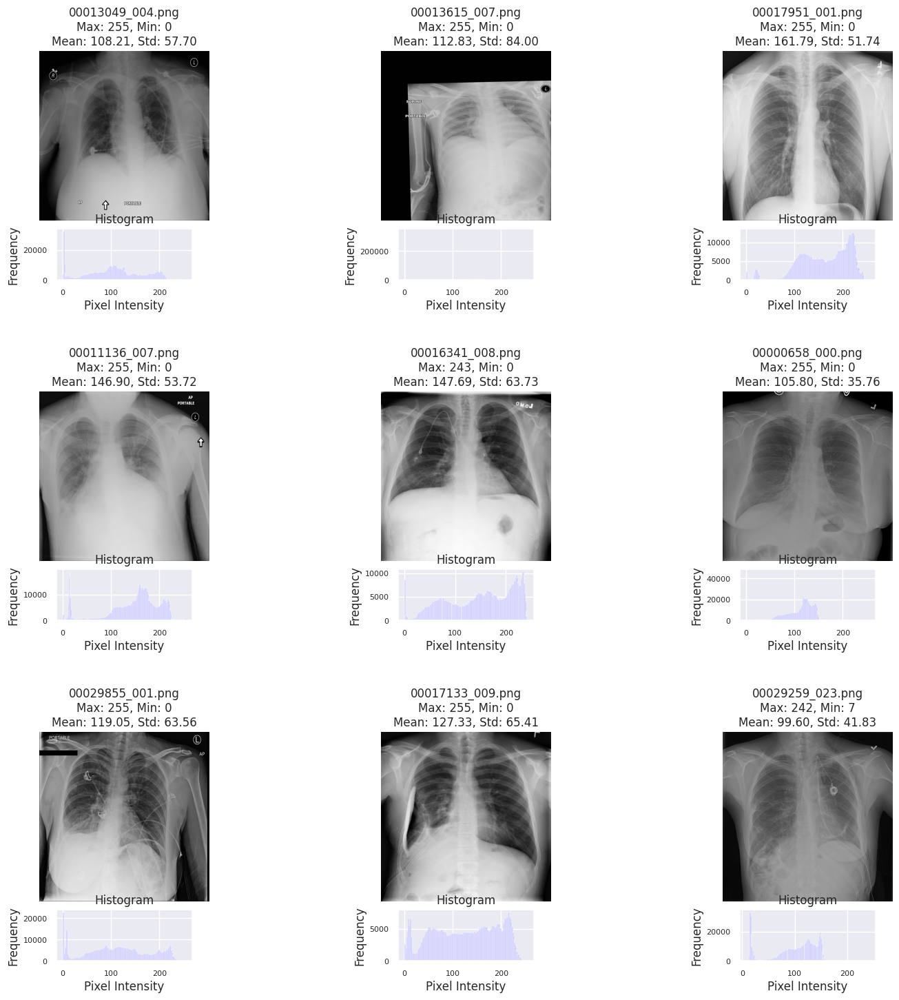

In [ ]:
import random
from skimage import io
import numpy as np
import matplotlib.pyplot as plt
import os

# Rastegele seçeceğimiz 9 görüntünün oluşturulduğu klasör
os.makedirs("/content/random_images", exist_ok=True)
# Seçeceğimiz rastgele görüntüleri kaydedeceğimiz klasör yolu
output_folder = "/content/random_images"

# Rastgele 9 görüntü seçme
sample_images = random.sample(list(train_df['Image']), 9)
fig, axes = plt.subplots(3, 3, figsize=(15, 15))

# Her bir görüntünün maksimum, minimum, ortalama ve standart sapma değerlerini hesaplama ve gösterme
for idx, image_name in enumerate(sample_images):
    # Görüntüyü yükle
    img_path = f"/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/nih/images_small/{image_name}"
    img = io.imread(img_path)

    # İstatistiksel özelliklerin hesaplanması
    max_val = np.max(img)
    min_val = np.min(img)
    mean_val = np.mean(img)
    std_dev = np.std(img)

    # Görüntü ve histogram çizimi
    ax_img = axes[idx // 3, idx % 3]
    ax_img.imshow(img, cmap='gray')
    ax_img.set_title(f"{image_name}\nMax: {max_val}, Min: {min_val}\nMean: {mean_val:.2f}, Std: {std_dev:.2f}")
    ax_img.axis('off')

    # Aynı hücrede histogram ekleme
    ax_hist = ax_img.inset_axes([0.1, -0.35, 0.8, 0.3])
    ax_hist.hist(img.ravel(), bins=256, color='blue', alpha=0.5)
    ax_hist.set_title("Histogram")
    ax_hist.set_xlabel("Pixel Intensity")
    ax_hist.set_ylabel("Frequency")
    ax_hist.tick_params(axis='both', which='major', labelsize=8)

    # Seçilen görüntüyü random_images klasörüne kaydetme
    save_path = os.path.join(output_folder, image_name)
    io.imsave(save_path, img)  # Görüntüyü kaydeder

plt.tight_layout()
plt.show()


Burada dataset içinden rastgele 9 farklı görüntü seçilir. Seçilen bu görüntülerin maksimum, minimum, ortalama ve standart sapma değerleri hesaplanır ve yazılır. Ayrıca bu görüntülerin histogramları çıkarılır. Bu görüntüler daha sonra kullanılmak üzere random_images klasörüne kaydedilir.

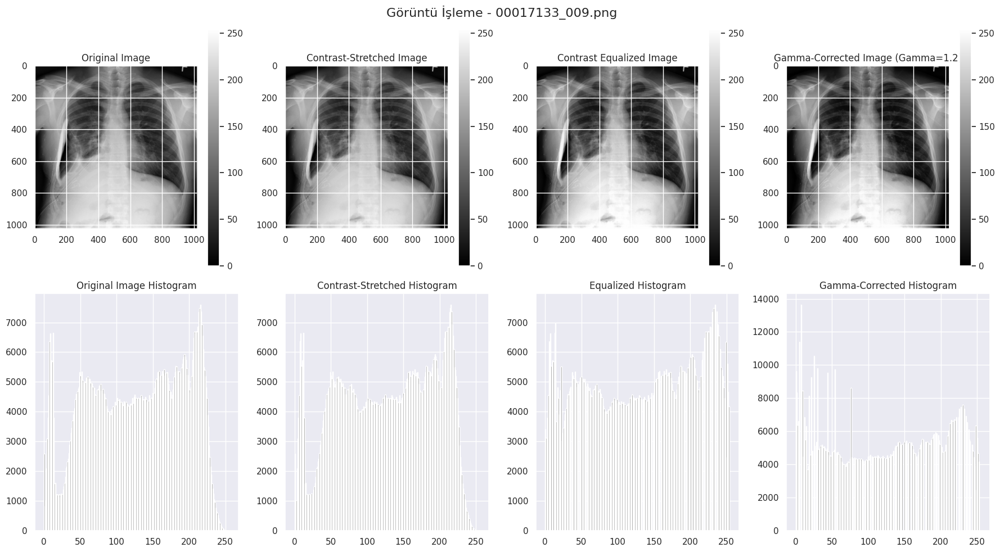

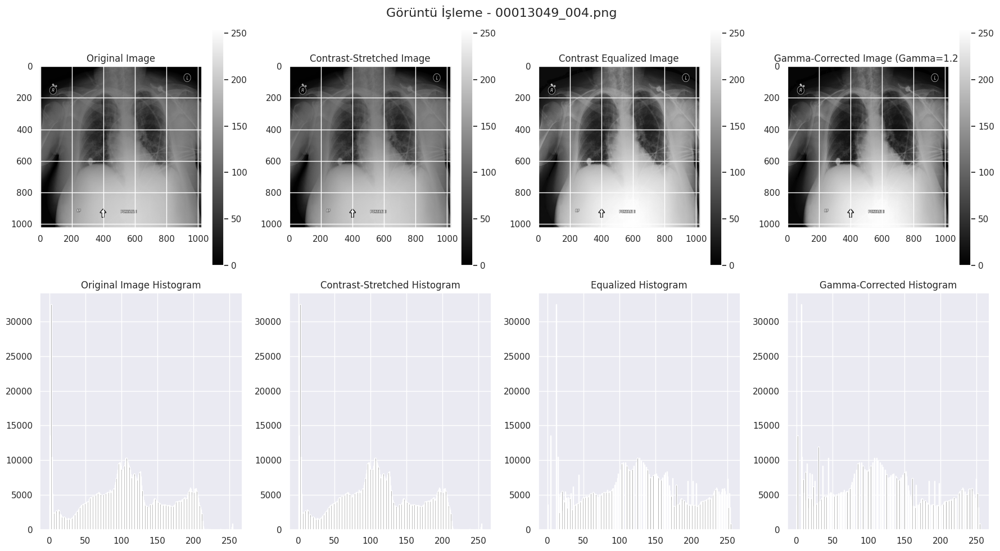

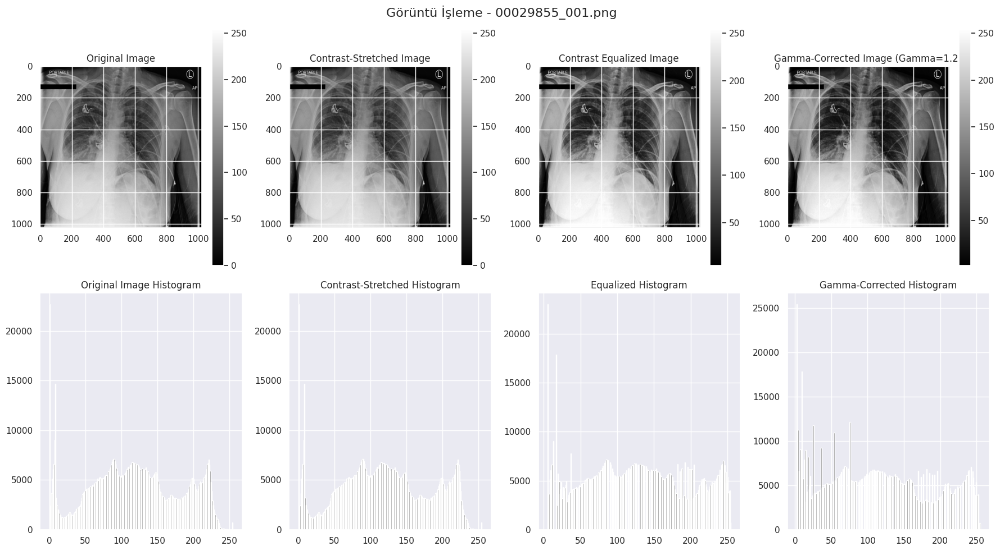

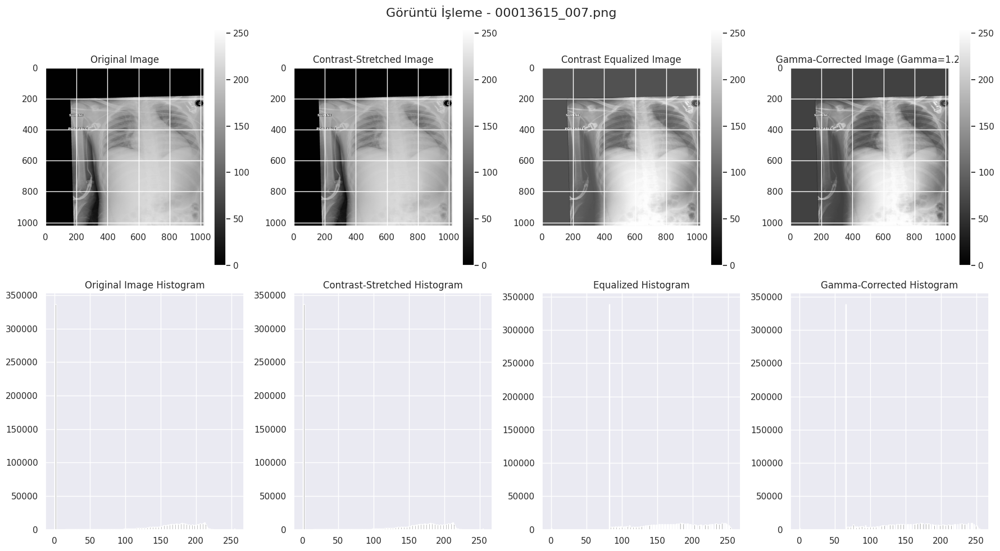

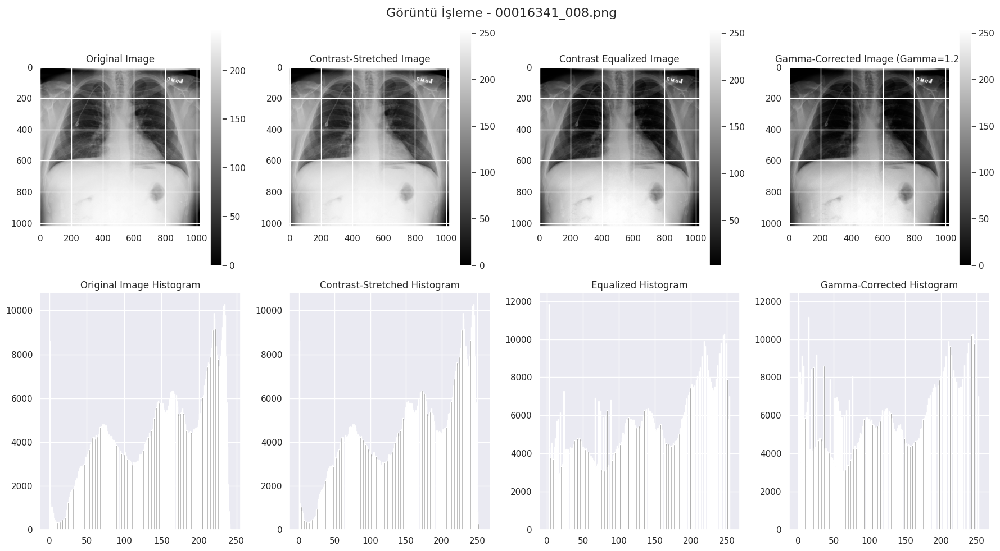

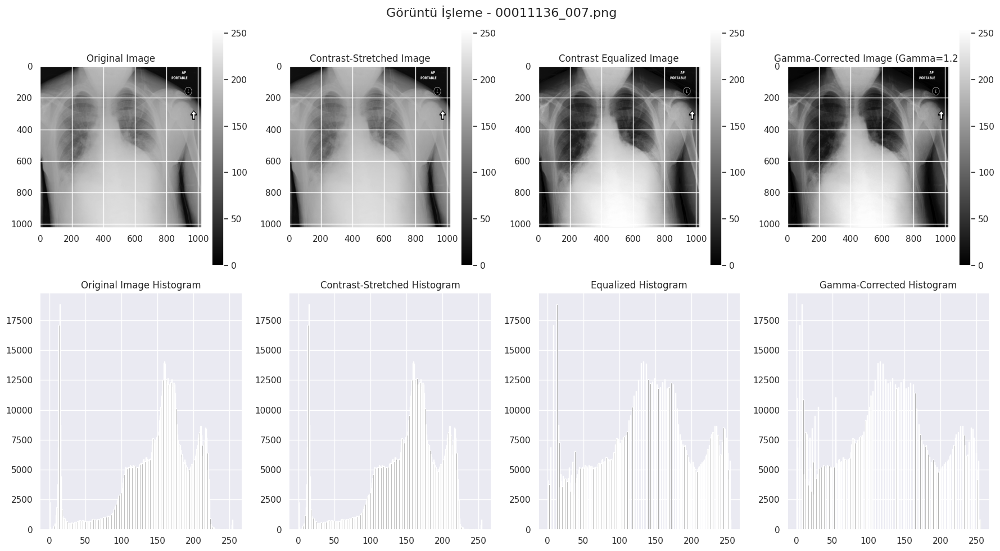

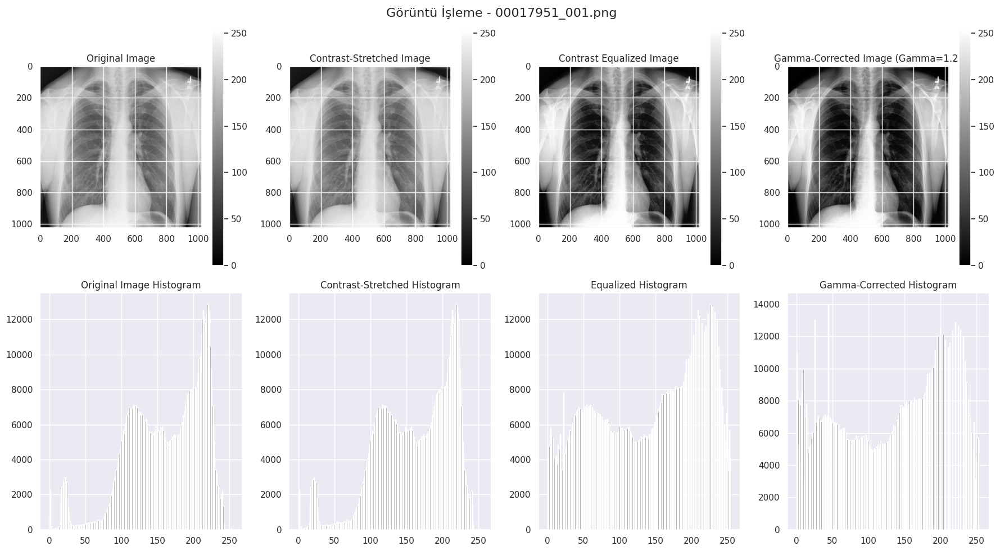

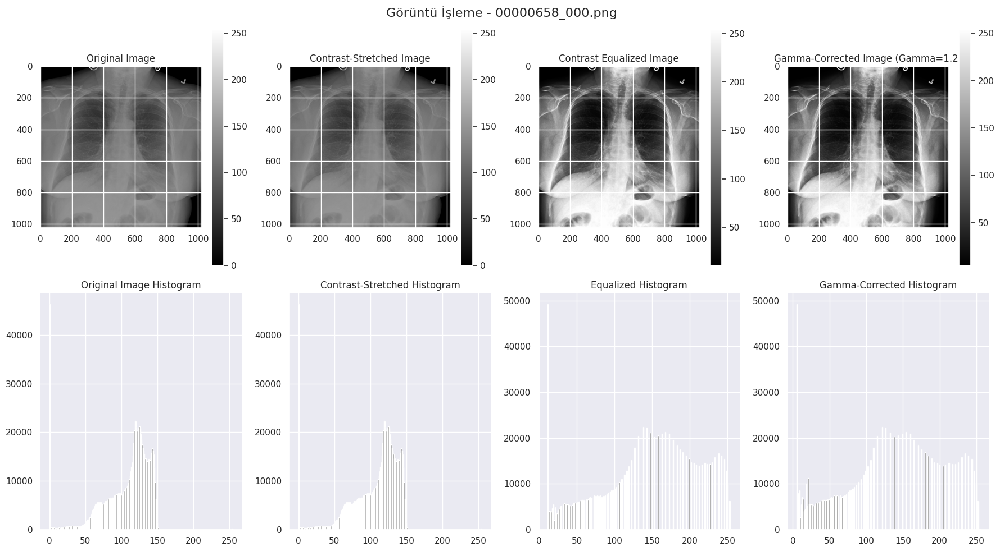

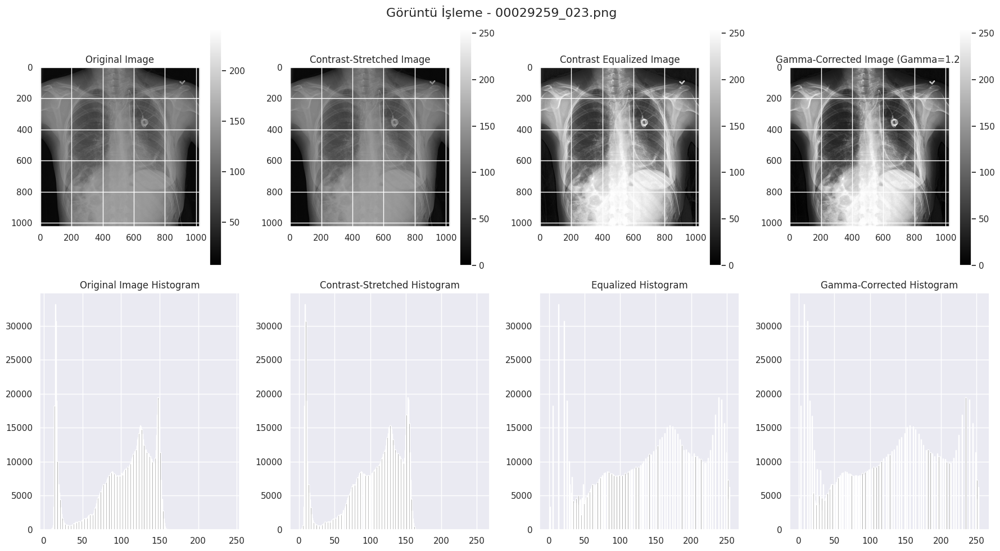

In [ ]:
from skimage import io, exposure

# Gamma düzeltilmiş görüntülerin oluşturulduğu klasör
os.makedirs("/content/gamma_corrected_images", exist_ok=True)

input_folder = "/content/random_images" # İşlem yapılacak klasör
output_folder = "/content/gamma_corrected_images"  # Gamma düzeltilmiş görüntülerin kaydedileceği klasör

# Klasördeki tüm görüntüleri listeleme
image_files = os.listdir(input_folder)

# Eğer çıktı klasörü yoksa oluştur
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

for image_name in image_files:
    # Görüntü yükleme
    image_path = os.path.join(input_folder, image_name)
    raw_image = io.imread(image_path)

    # Minimum ve maksimum hesaplama, kontrast germe işlemi uygulama
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize to [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # Scale to [0, 255]

    # Histogram eşitleme işlemi uygulama
    equalized_image = exposure.equalize_hist(contrast_stretched)  # Returns values in [0, 1]
    equalized_image = (equalized_image * 255).astype(np.uint8)    # Scale to [0, 255]

    # Gamma düzeltme işlemi uygulama
    gamma = 1.2
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Gamma düzeltilmiş görüntüyü kaydetme
    output_image_path = os.path.join(output_folder, f"gamma_corrected_{image_name}")
    io.imsave(output_image_path, gamma_corrected)

    # Orijinal görüntüleri, işlenmiş görüntüleri ve histogramları görselleştirme
    plt.figure(figsize=(18, 10))
    plt.suptitle(f"Görüntü İşleme - {image_name}", fontsize=16)

    # Orijinal görüntü ve histogramı
    plt.subplot(2, 4, 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title('Original Image')
    plt.colorbar()
    plt.subplot(2, 4, 5)
    plt.hist(raw_image.ravel(), bins=256, color='gray')
    plt.title("Original Image Histogram")

    # Kontrast gerilmiş görüntü ve histogramı
    plt.subplot(2, 4, 2)
    plt.imshow(contrast_stretched, cmap='gray')
    plt.title('Contrast-Stretched Image')
    plt.colorbar()
    plt.subplot(2, 4, 6)
    plt.hist(contrast_stretched.ravel(), bins=256, color='gray')
    plt.title("Contrast-Stretched Histogram")

    # Histogram eşitlenmiş görüntü ve histogramı
    plt.subplot(2, 4, 3)
    plt.imshow(equalized_image, cmap='gray')
    plt.title('Contrast Equalized Image')
    plt.colorbar()
    plt.subplot(2, 4, 7)
    plt.hist(equalized_image.ravel(), bins=256, color='gray')
    plt.title("Equalized Histogram")

    # Gamma düzeltmesi uygulanmış görüntü ve histogramı
    plt.subplot(2, 4, 4)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title(f'Gamma-Corrected Image (Gamma={gamma})')
    plt.colorbar()
    plt.subplot(2, 4, 8)
    plt.hist(gamma_corrected.ravel(), bins=256, color='gray')
    plt.title("Gamma-Corrected Histogram")

    plt.tight_layout()
    plt.show()


Rastgele seçilmiş görüntülere kontrast germe, histogram eşitleme ve gamma düzeltme uygulanmıştır. Ayrıca sonraki soruda kullanılmak üzere gamma düzeltilmiş görüntüler gamma_corrected_images klasörüne kaydedilmiştir.

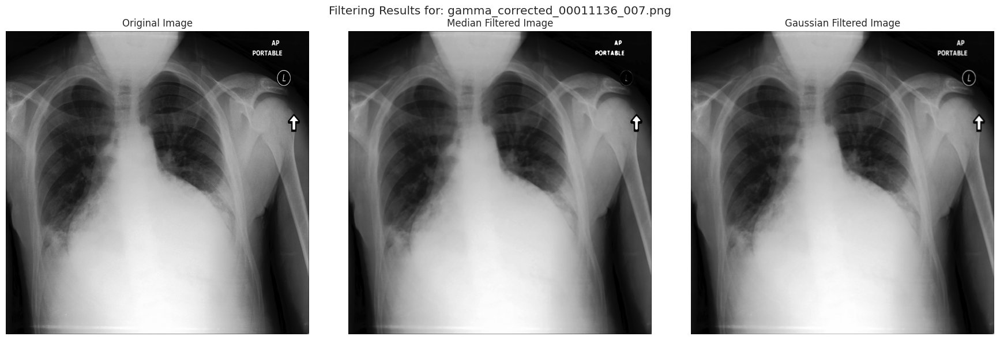

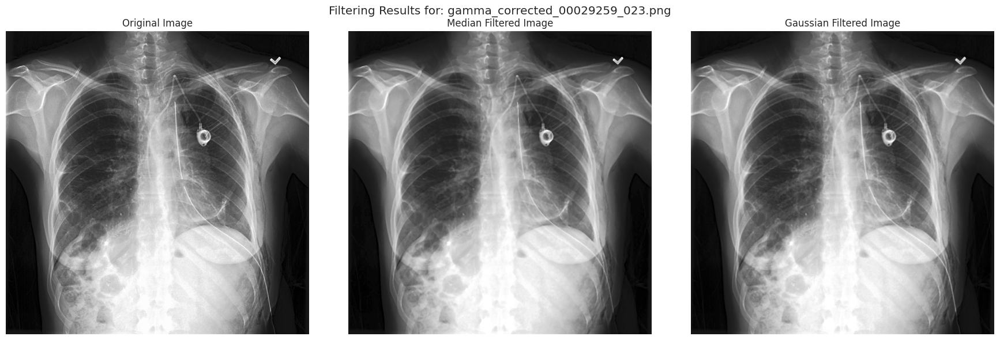

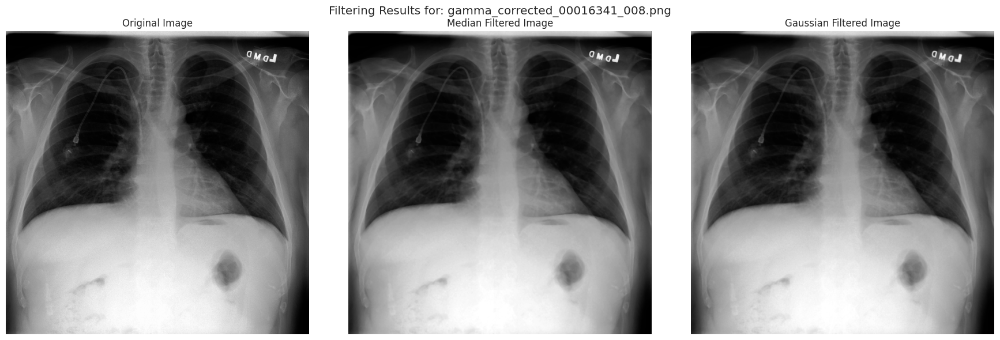

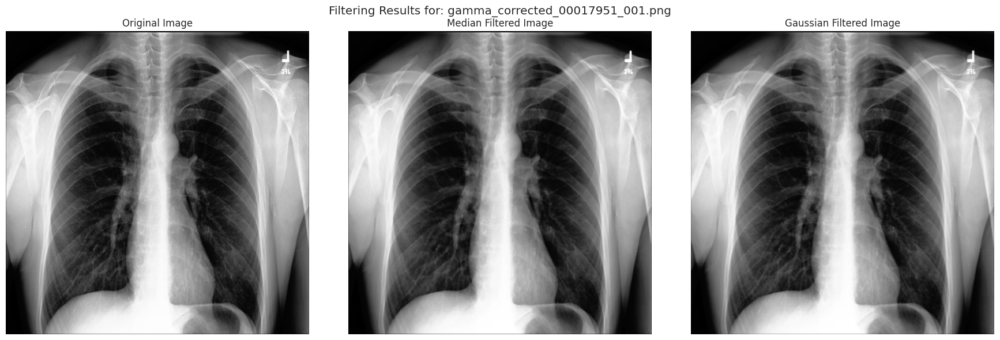

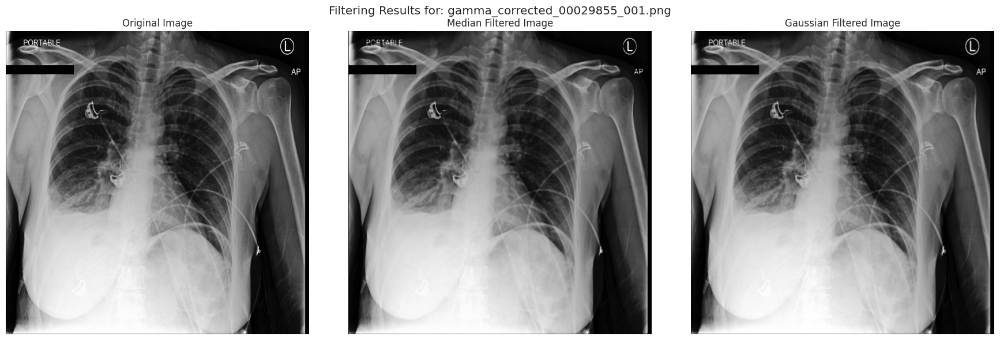

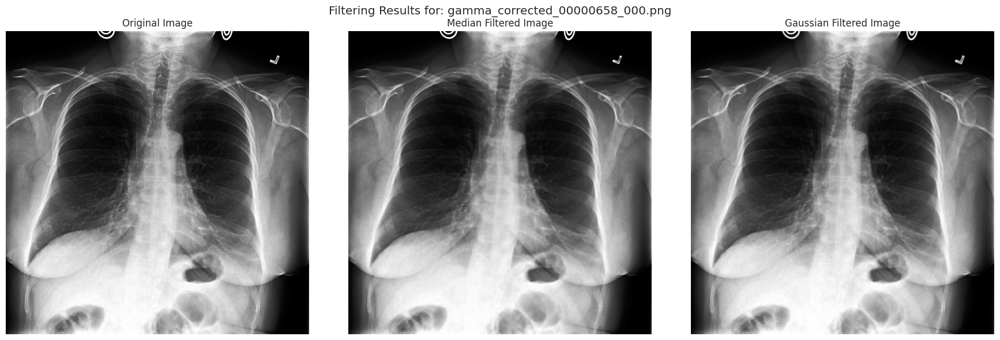

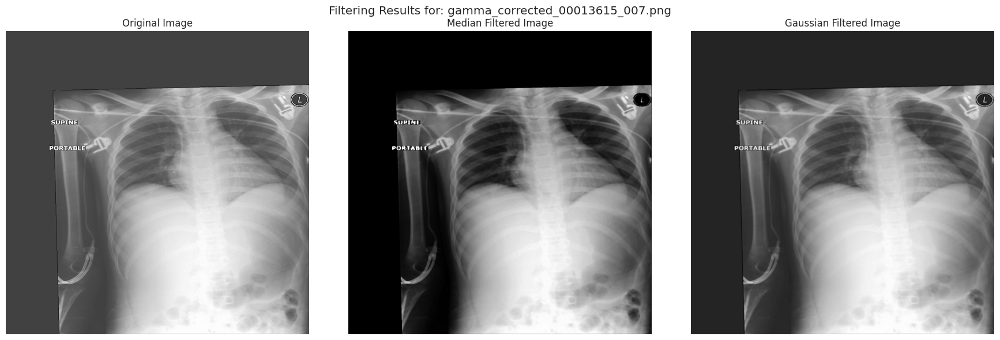

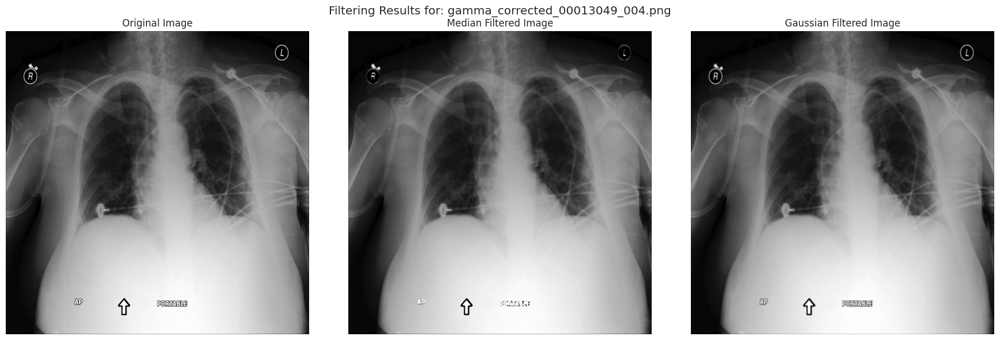

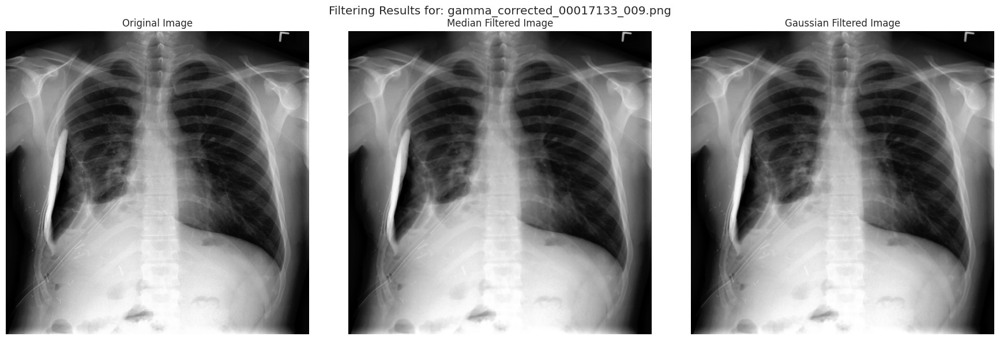

In [ ]:
import cv2

# Gamma düzeltilmiş görüntülerin olduğu klasör yolu
folder_path = "/content/gamma_corrected_images"

# Klasördeki tüm görüntü dosyalarını okuma
image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Her bir görüntü üzerinde filtreleme işlemleri uygulama
for image_file in image_files:
    # Görüntüyü yükleme
    img_path = os.path.join(folder_path, image_file)
    gamma_corrected = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

    # Median Filtering işlemi
    median_filtered = cv2.medianBlur(gamma_corrected, 5)

    # Gaussian Blur işlemi
    gaussian_filtered = cv2.GaussianBlur(gamma_corrected, (5, 5), 0)

    # Sonuçları görselleştirme
    plt.figure(figsize=(18, 6))

    # Orijinal görüntü
    plt.subplot(1, 3, 1)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title("Original Image")
    plt.axis("off")

    # Median filtrelenmiş görüntü
    plt.subplot(1, 3, 2)
    plt.imshow(median_filtered, cmap='gray')
    plt.title("Median Filtered Image")
    plt.axis("off")

    # Gaussian filtrelenmiş görüntü
    plt.subplot(1, 3, 3)
    plt.imshow(gaussian_filtered, cmap='gray')
    plt.title("Gaussian Filtered Image")
    plt.axis("off")

    plt.suptitle(f"Filtering Results for: {image_file}")
    plt.tight_layout()
    plt.show()



Gamma düzeltilmiş görüntüler üzerinde Median Filtering ve Gaussian Filtering işlemleri uygulanmıştır.

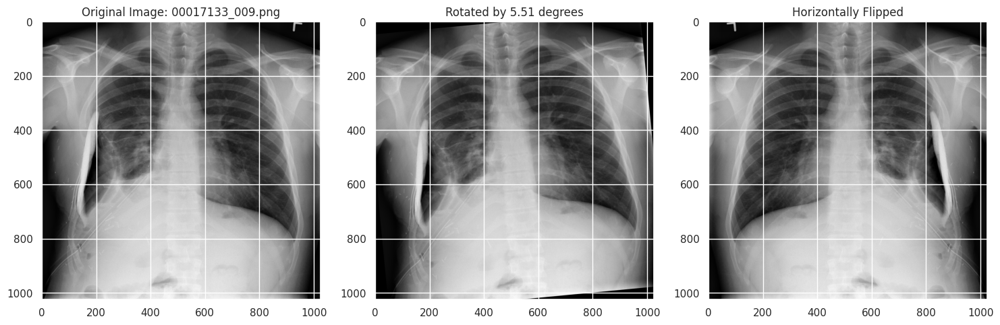

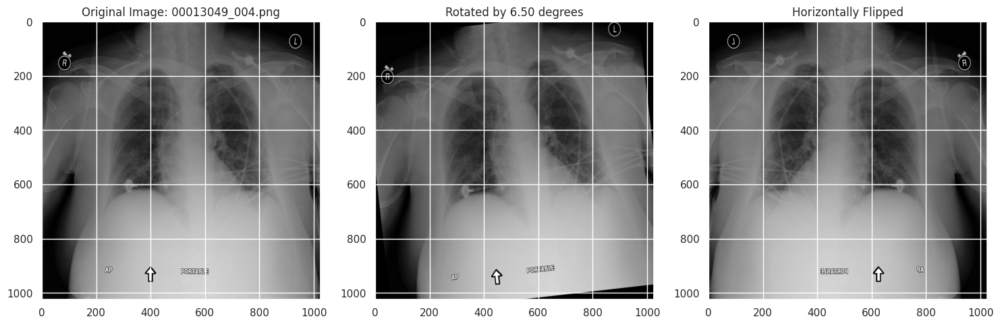

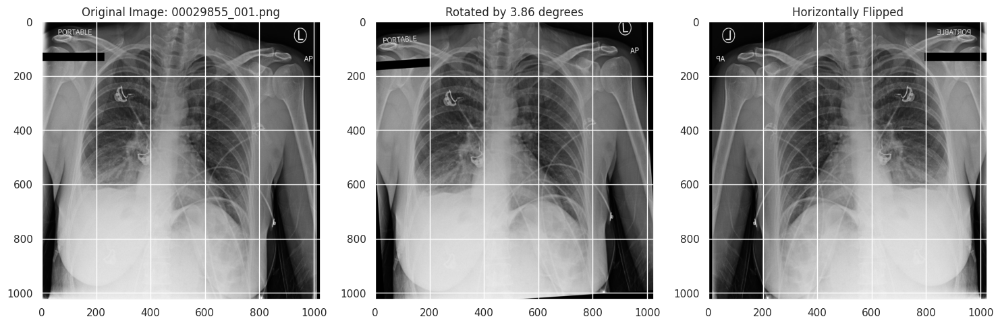

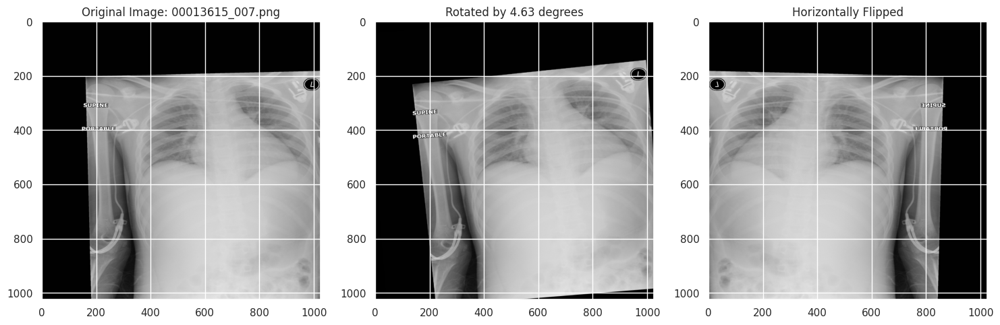

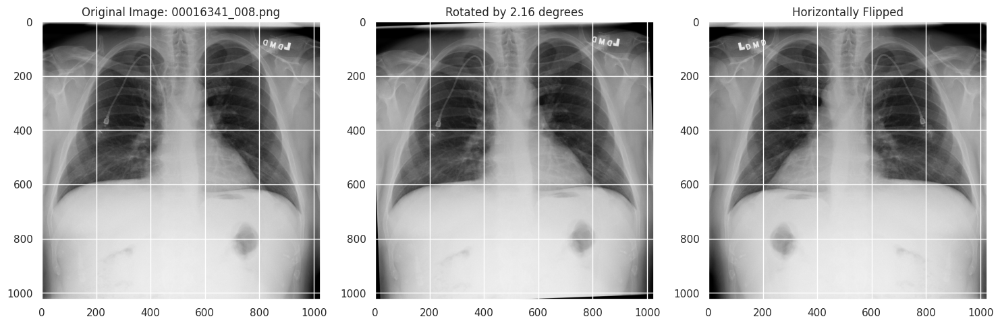

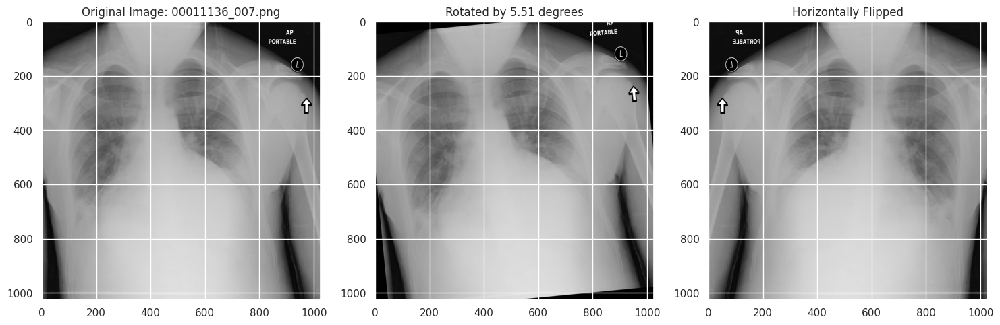

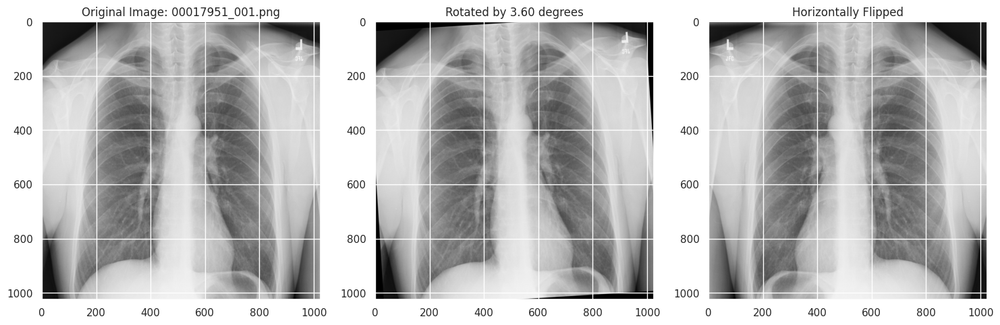

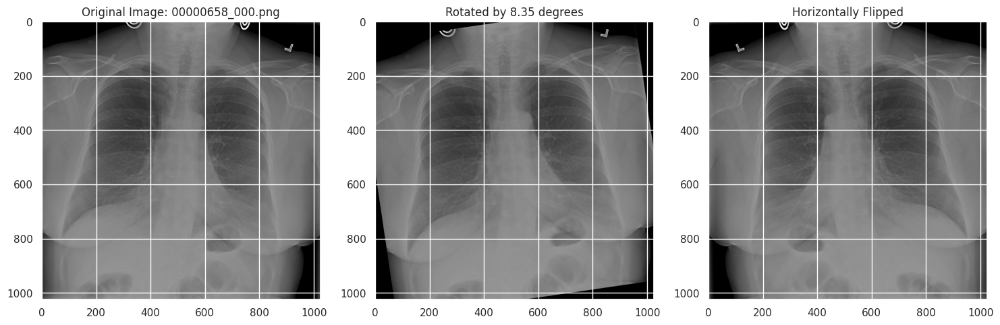

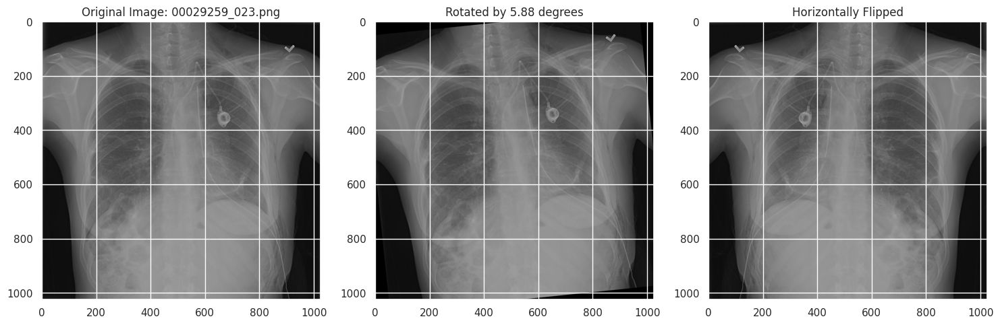

In [ ]:

# Görüntülerin olduğu klasör yolu
folder_path = "/content/random_images"

# Klasördeki tüm görüntü dosyalarını okuma
image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Her bir görüntü üzerinde döndürme ve flip işlemleri uygulama
for image_file in image_files:
    # Görüntüyü yükleme
    img_path = os.path.join(folder_path, image_file)
    image = cv2.imread(img_path)

    # Görüntü boyutlarını alma
    height, width = image.shape[:2]

    # Rastgele bir derece seçme (0 ile 10 arasında)
    angle = random.uniform(0, 10)

    # Görüntünün merkezini bulma
    center = (width // 2, height // 2)

    # Döndürme matrisi oluşturma
    rotation_matrix = cv2.getRotationMatrix2D(center, angle, 1.0)

    # Görüntüyü döndürme
    rotated_image = cv2.warpAffine(image, rotation_matrix, (width, height))

    # Yatay flip işlemi uygulama
    flipped_image = cv2.flip(image, 1)

    # Sonuçları görselleştirme
    plt.figure(figsize=(15, 5))

    # Orijinal görüntü
    plt.subplot(1, 3, 1)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title(f"Original Image: {image_file}")

    # Döndürülmüş görüntü
    plt.subplot(1, 3, 2)
    plt.imshow(cv2.cvtColor(rotated_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Rotated by {angle:.2f} degrees")

    # Yatay flip uygulanmış görüntü
    plt.subplot(1, 3, 3)
    plt.imshow(cv2.cvtColor(flipped_image, cv2.COLOR_BGR2RGB))
    plt.title("Horizontally Flipped")

    plt.tight_layout()
    plt.show()


random_images kalsöründeki rastgele seçilmiş 9 görüntü üzerinde 0 ile 10 derece arasında rastgele döndürme işlemleri uygulanmıştır. Ayrıca seçilen bu görüntüler üzerinde Horizontally Flipped işlemi uygulanmıştır.

İşlenen görüntü: 00017133_009.png


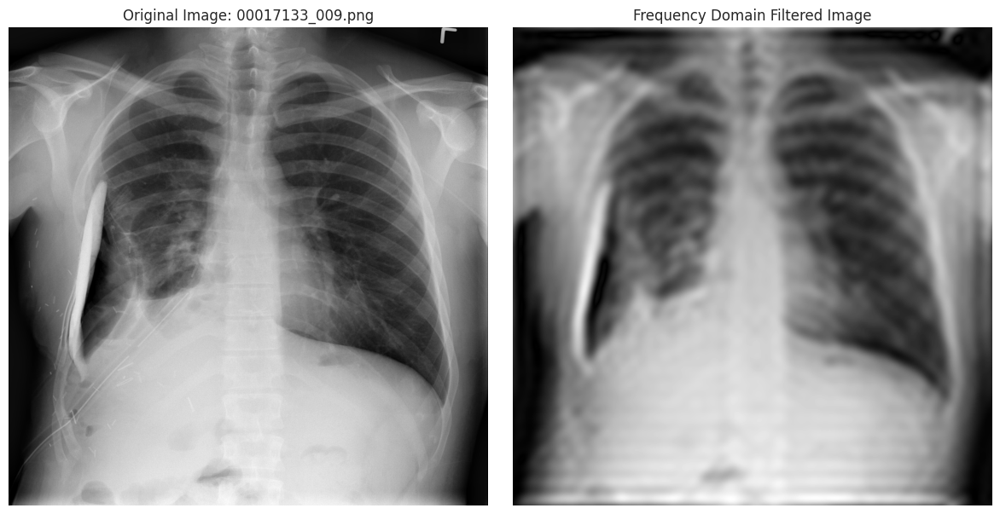

İşlenen görüntü: 00013049_004.png


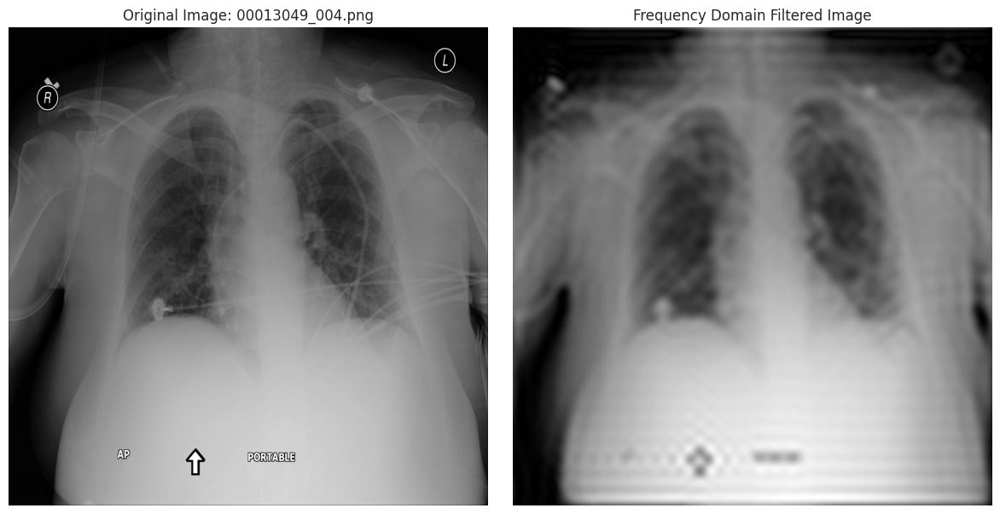

İşlenen görüntü: 00029855_001.png


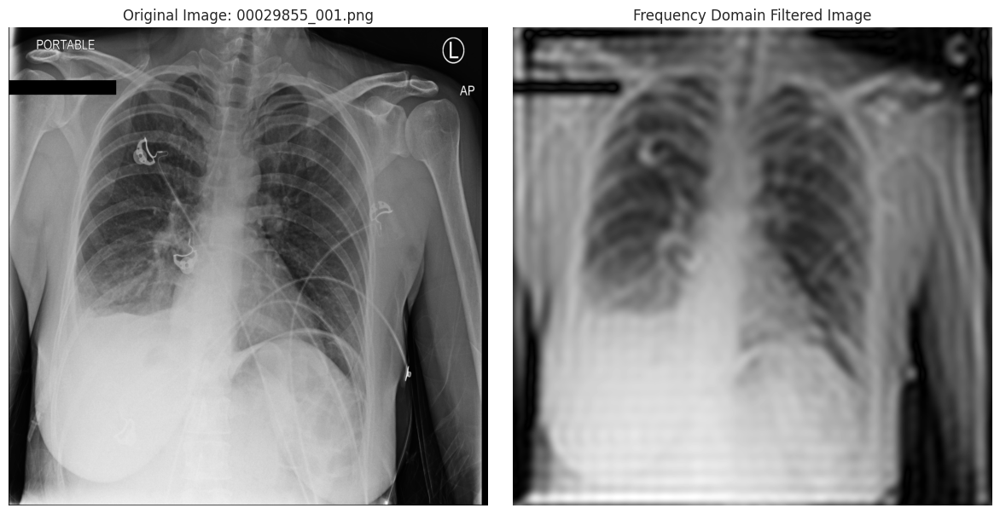

İşlenen görüntü: 00013615_007.png


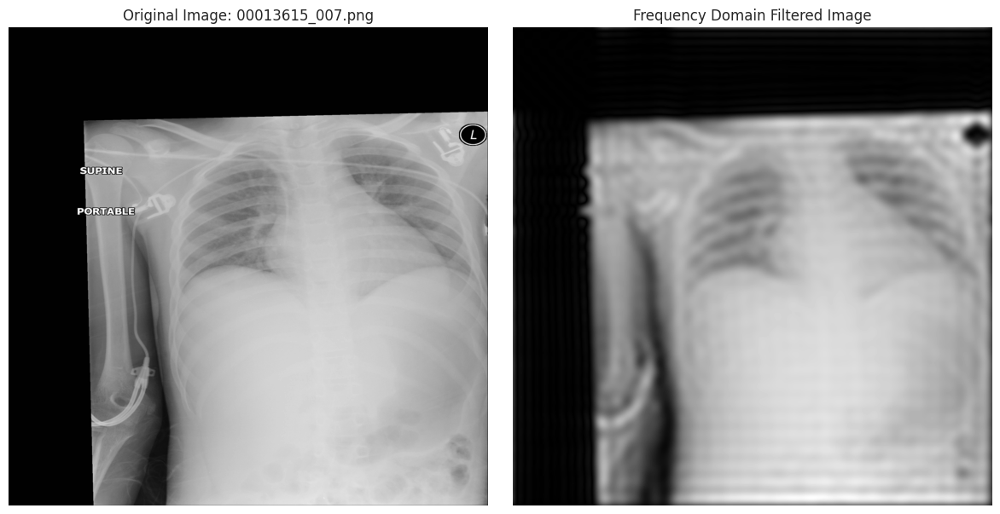

İşlenen görüntü: 00016341_008.png


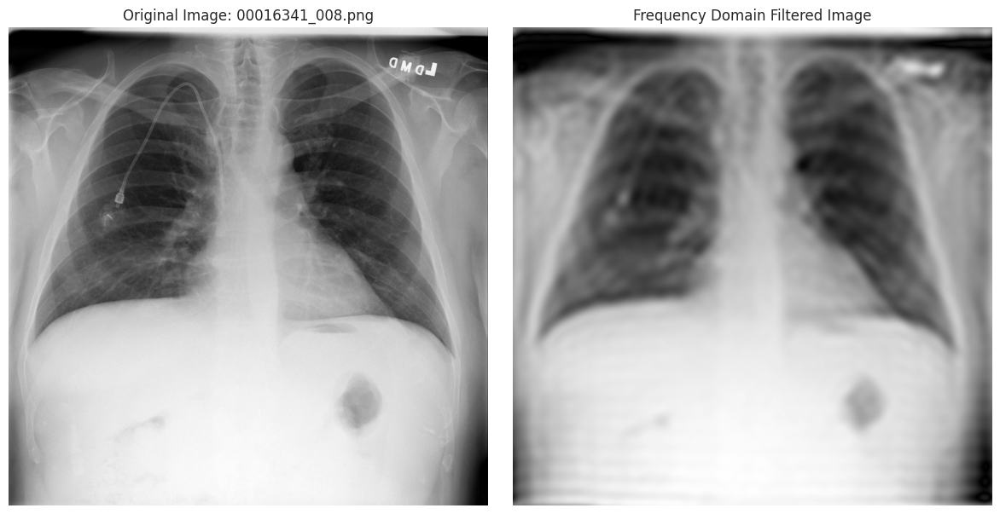

İşlenen görüntü: 00011136_007.png


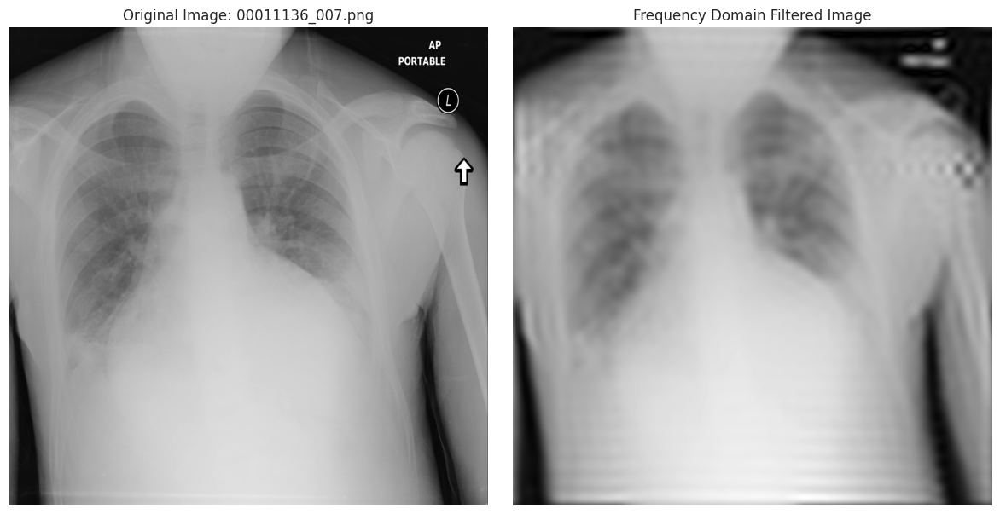

İşlenen görüntü: 00017951_001.png


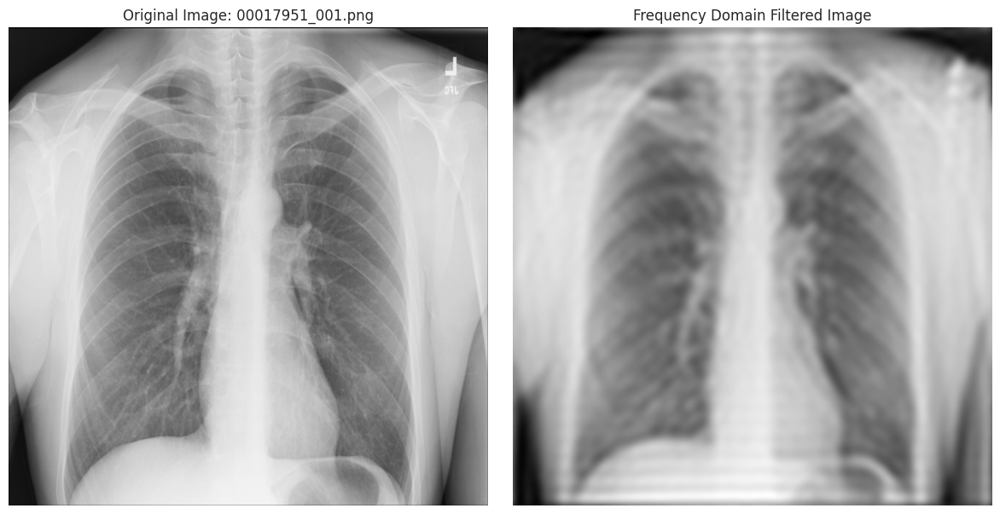

İşlenen görüntü: 00000658_000.png


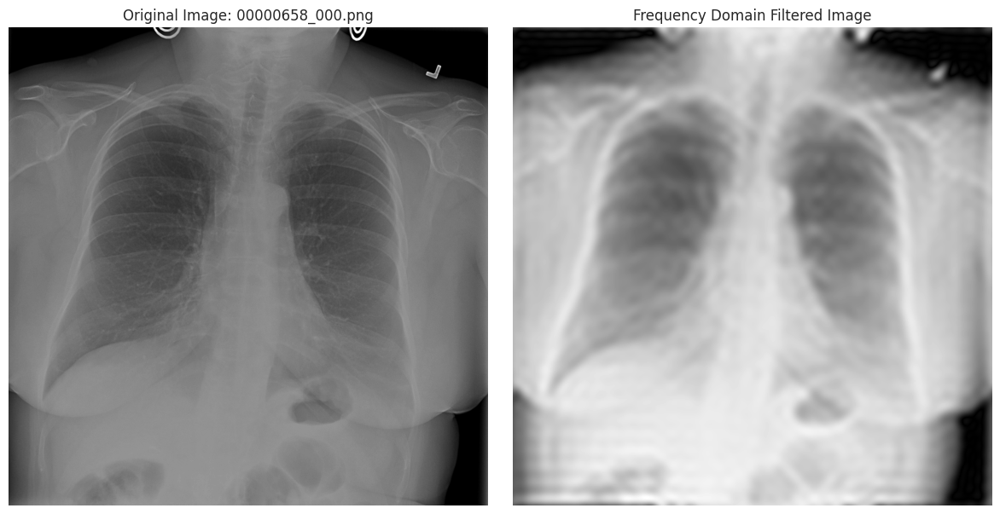

İşlenen görüntü: 00029259_023.png


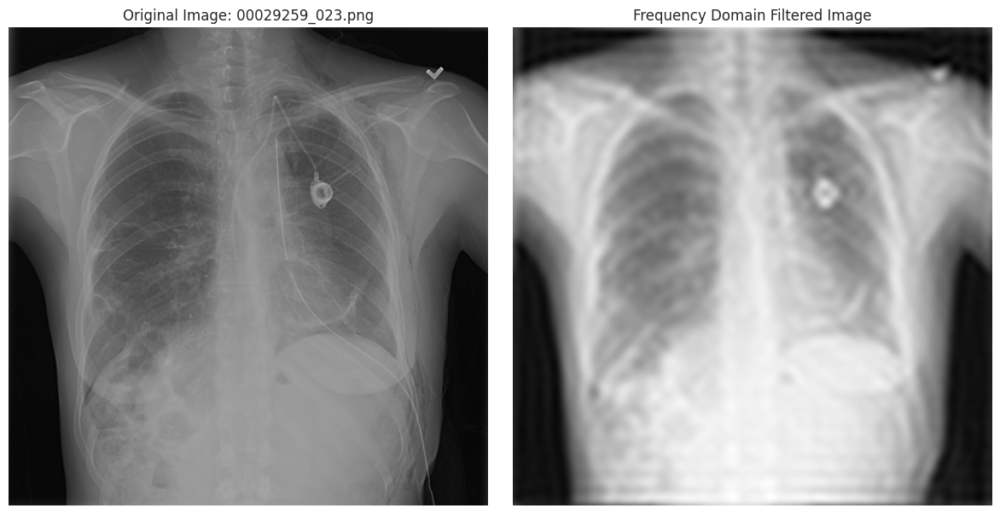

In [ ]:

# Görüntülerin bulunduğu klasör yolu
folder_path = "/content/random_images"

# Klasördeki tüm görüntü dosyalarını okuma
image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Klasördeki her bir görüntü üzerinde döngü ile işlemleri uygulama
for image_file in image_files:
    # Görüntü dosyasının tam yolunu oluşturma
    img_path = os.path.join(folder_path, image_file)

    # Görüntüyü gri tonlamalı olarak yükleme
    image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

    print(f"İşlenen görüntü: {image_file}")

    # Görüntüye Fourier dönüşümü uygulama ve frekansları merkeze kaydırma
    dft = cv2.dft(np.float32(image), flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shifted = np.fft.fftshift(dft)

    # Görüntü boyutlarını alma
    rows, cols = image.shape
    crow, ccol = rows // 2, cols // 2

    # Düşük frekansları geçiren bir maske oluşturma (merkezi bir kare)
    mask = np.zeros((rows, cols, 2), np.uint8)
    mask[crow-30:crow+30, ccol-30:ccol+30] = 1  # Merkezdeki düşük frekansları geçirme

    # Maskeyi frekans alanına uygulama
    fshift = dft_shifted * mask

    # Ters Fourier dönüşümü ile frekans alanında filtreleme yapma
    f_ishift = np.fft.ifftshift(fshift)
    filtered_image = cv2.idft(f_ishift)
    filtered_image = cv2.magnitude(filtered_image[:, :, 0], filtered_image[:, :, 1])

    # Görüntüyü normalize etme (0-255 arası)
    filtered_image = cv2.normalize(filtered_image, None, 0, 255, cv2.NORM_MINMAX)
    filtered_image = np.uint8(filtered_image)

    # Sonuçları görselleştirme
    plt.figure(figsize=(12, 6))

    # Orijinal görüntü
    plt.subplot(1, 2, 1)
    plt.imshow(image, cmap='gray')
    plt.title(f"Original Image: {image_file}")
    plt.axis("off")

    # Frekans alanında filtrelenmiş görüntü
    plt.subplot(1, 2, 2)
    plt.imshow(filtered_image, cmap='gray')
    plt.title("Frequency Domain Filtered Image")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


random_images klasöründeki görüntülere Fourier dönüşümü ile görüntüyü frekans alanına çevirme, düşük frekansları geçiren bir maske uygulama, ardından ters Fourier dönüşümü ile frekans alanında filtreleme işlemleri uygulanmıştır.

İşlenen görüntü: 00017133_009.png


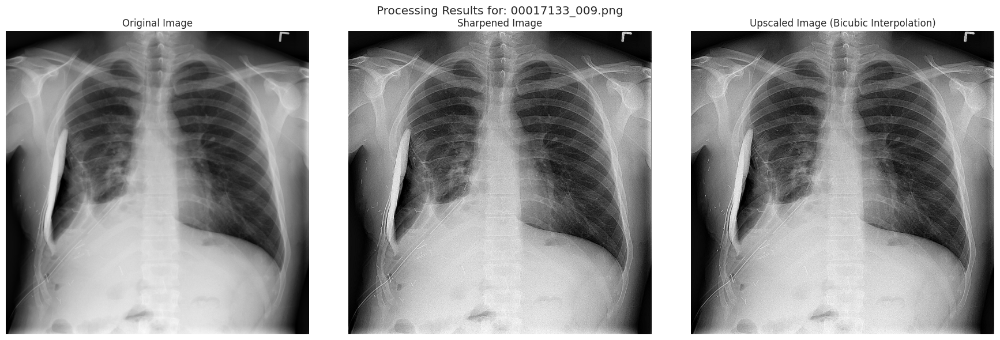

İşlenen görüntü: 00013049_004.png


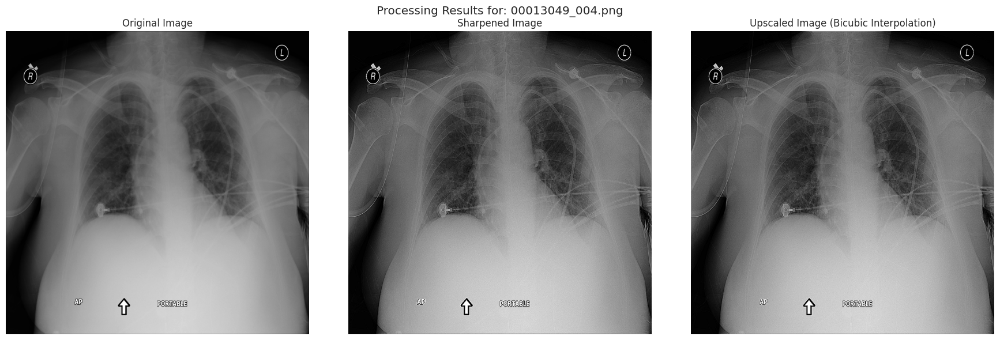

İşlenen görüntü: 00029855_001.png


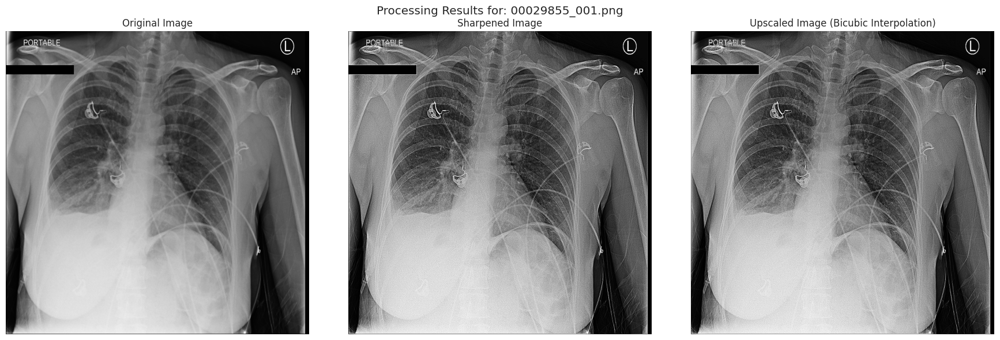

İşlenen görüntü: 00013615_007.png


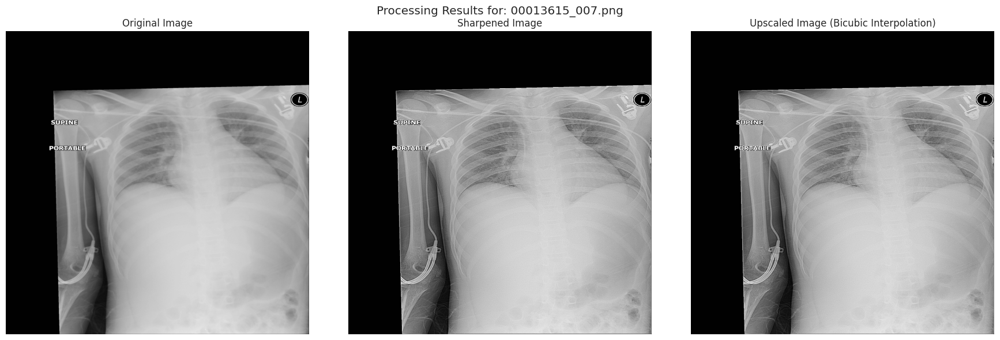

İşlenen görüntü: 00016341_008.png


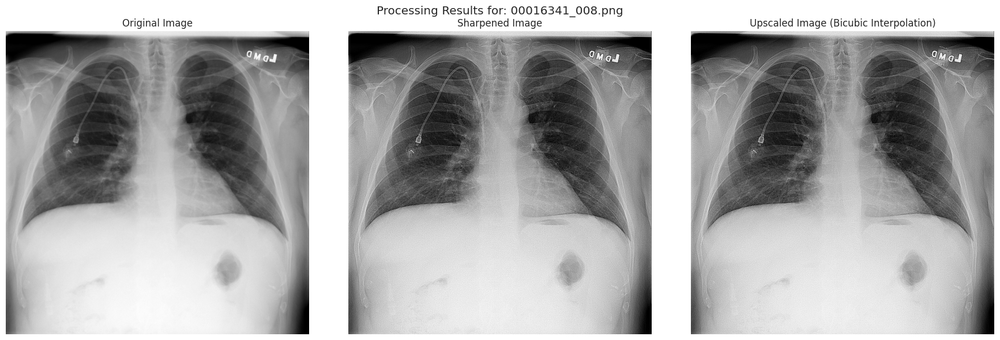

İşlenen görüntü: 00011136_007.png


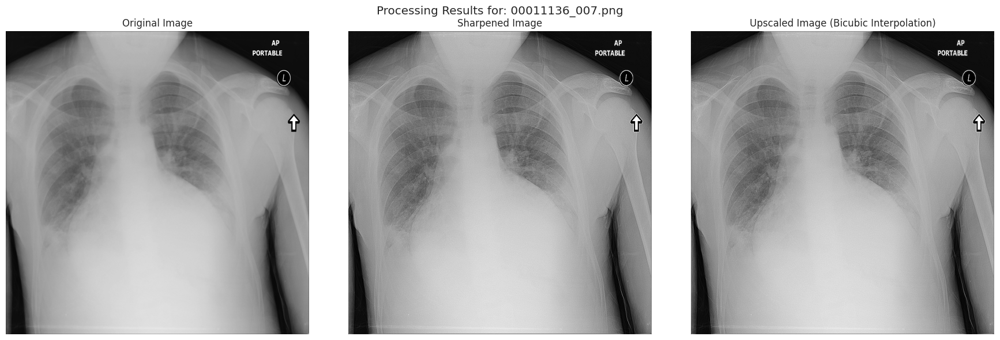

İşlenen görüntü: 00017951_001.png


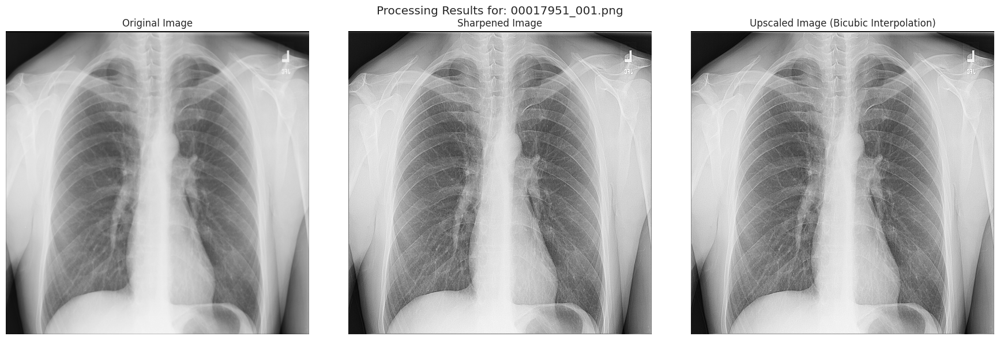

İşlenen görüntü: 00000658_000.png


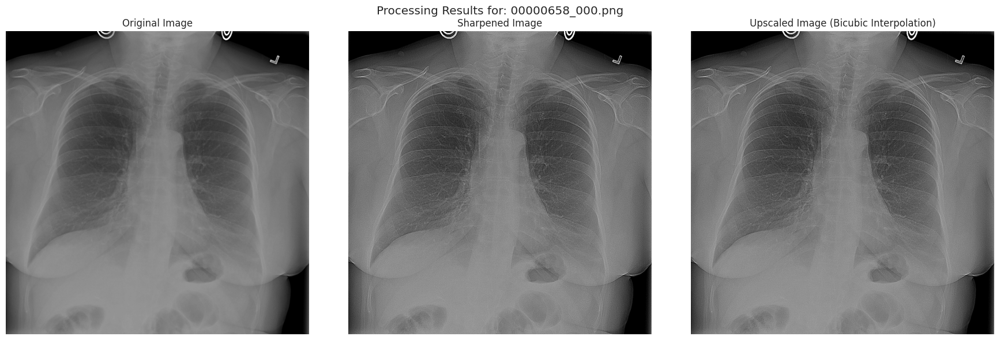

İşlenen görüntü: 00029259_023.png


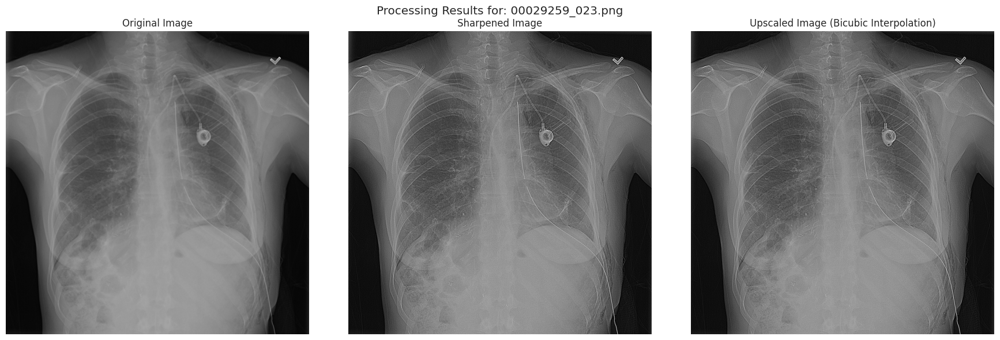

In [ ]:
from scipy.ndimage import zoom

# Görüntülerin bulunduğu klasör yolu
folder_path = "/content/random_images"

# Klasördeki tüm görüntü dosyalarını okuma
image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Her bir görüntü üzerinde döngü ile işlemleri uygulama
for image_file in image_files:
    # Görüntü dosyasının tam yolunu oluştur
    img_path = os.path.join(folder_path, image_file)

    # Görüntüyü gri tonlamalı olarak yükleme
    image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

    if image is None:
        print(f"Görüntü yüklenemedi: {image_file}")
        continue

    print(f"İşlenen görüntü: {image_file}")

    # Adım 1: Keskinleştirme filtresi uygulama (unsharp masking)
    sharpening_kernel = np.array([[-1, -1, -1],
                                  [-1,  9, -1],
                                  [-1, -1, -1]])
    sharpened_image = cv2.filter2D(image, -1, sharpening_kernel)
    sharpened_image = np.clip(sharpened_image, 0, 255).astype(np.uint8)

    # Adım 2: Bicubic enterpolasyon ile görüntüyü büyütme (2 kat)
    scale_factor = 2
    resized_image = zoom(sharpened_image, scale_factor, order=3)  # Bicubic interpolation with order=3

    # Sonuçları görselleştirme
    plt.figure(figsize=(18, 6))

    # Orijinal görüntü
    plt.subplot(1, 3, 1)
    plt.imshow(image, cmap='gray')
    plt.title("Original Image")
    plt.axis("off")

    # Keskinleştirilmiş görüntü
    plt.subplot(1, 3, 2)
    plt.imshow(sharpened_image, cmap='gray')
    plt.title("Sharpened Image")
    plt.axis("off")

    # Enterpolasyon ile büyütülmüş görüntü
    plt.subplot(1, 3, 3)
    plt.imshow(resized_image, cmap='gray')
    plt.title("Upscaled Image (Bicubic Interpolation)")
    plt.axis("off")

    plt.suptitle(f"Processing Results for: {image_file}")
    plt.tight_layout()
    plt.show()



random_images klasöründeki görüntülere Unsharp masking tekniği kullanarak görüntüyü keskinleştirme ve keskinleştirilmiş görüntüyü iki kat büyüterek Bubic Enterpolasyon uygulanmıştır.